<a href="https://colab.research.google.com/github/rameshavinash94/Customer_Segmentation_Clustering/blob/main/Customer_Segmentation_added_assignment_2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Customer Segmentation using RFM and Clustering**

**A project of the Olist store Ecommerce Analysis**

**Using RFM Analysis and Clustering techniques like K-Means,AgglomerativeClustering to Investigate Customer Segmentation**



**Our Business Problem:**

*Dividing customers into groups for the purpose of targeting advertisements or promotions (based on purchasing patterns,purchase history)*

**NOTE:** The Data is Highely Skewed So, results won't be perfectly accurate.

#### **IMPORTING LIBRARIES**

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import missingno as msno
import seaborn as sns
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, calinski_harabasz_score, davies_bouldin_score
import plotly.express as px
from sklearn.mixture import GaussianMixture

**Load the datasets**

In [ ]:
customers = pd.read_csv('olist_customers_dataset.csv')
order_items = pd.read_csv('olist_order_items_dataset.csv')
order_payment= pd.read_csv('olist_order_payments_dataset.csv')
geolocation = pd.read_csv('olist_geolocation_dataset.csv')
order_reviews = pd.read_csv('olist_order_reviews_dataset.csv')
orders = pd.read_csv('olist_orders_dataset.csv')
products = pd.read_csv('olist_products_dataset.csv')
sellers = pd.read_csv('olist_sellers_dataset.csv')
product_category_name = pd.read_csv('product_category_name_translation.csv')

The ER/Data Modeling Structure of the Datasource
<div>
<img src='https://i.imgur.com/HRhd2Y0.png'>
</div>


*We won't require all the above datasets for our current business usecase for customer segmentation, so selectiong on the necessary files and carryon the EDA and data wrangling on the datasets.*

#### **DATA INTEGRATION AND FEATURE EXTRACTION**

Now Lets merge the required datasets into a single data source for analysis.

In [ ]:
#merge all seller info with all order info
seller_orders=pd.merge(order_items,sellers, how='inner')
df_order = pd.merge(orders, seller_orders, how='inner')
final_order_df = pd.merge(df_order, order_payment,how='inner')

In [ ]:
#merge all products
df_products = pd.merge(product_category_name,products, how='inner')
products_order = pd.merge(final_order_df,df_products)

In [ ]:
#merged the above dataframe with customers to get final dataframe
customer_orders = pd.merge(products_order, customers,how='inner')

In [ ]:
#create new df with final_df as name for understanding
final_df=customer_orders

In [ ]:
#data shape
final_df.shape

(115878, 34)

In [ ]:
#list of columns
final_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date',
       'order_item_id', 'product_id', 'seller_id', 'shipping_limit_date',
       'price', 'freight_value', 'seller_zip_code_prefix', 'seller_city',
       'seller_state', 'payment_sequential', 'payment_type',
       'payment_installments', 'payment_value', 'product_category_name',
       'product_category_name_english', 'product_name_lenght',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id', 'customer_zip_code_prefix', 'customer_city',
       'customer_state'],
      dtype='object')

In [ ]:
#view the dataframe
final_df

,order_id,customer_id,order_status,order_purchase_timestamp,order_approved_at,order_delivered_carrier_date,order_delivered_customer_date,order_estimated_delivery_date,order_item_id,product_id,...,product_description_lenght,product_photos_qty,product_weight_g,product_length_cm,product_height_cm,product_width_cm,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state
0,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
1,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
2,e481f51cbdc54678b7cc49136f2d6af7,9ef432eb6251297304e76186b10a928d,delivered,2017-10-02 10:56:33,2017-10-02 11:07:15,2017-10-04 19:55:00,2017-10-10 21:25:13,2017-10-18 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,7c396fd4830fd04220f754e42b4e5bff,3149,sao paulo,SP
3,128e10d95713541c87cd1a2e48201934,a20e8105f23924cd00833fd87daa0831,delivered,2017-08-15 18:29:31,2017-08-15 20:05:16,2017-08-17 15:28:33,2017-08-18 14:44:43,2017-08-28 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,3a51803cc0d012c3b5dc8b7528cb05f7,3366,sao paulo,SP
4,0e7e841ddf8f8f2de2bad69267ecfbcf,26c7ac168e1433912a51b924fbd34d34,delivered,2017-08-02 18:24:47,2017-08-02 18:43:15,2017-08-04 17:35:43,2017-08-07 18:30:01,2017-08-15 00:00:00,1,87285b34884572647811a353c7ac498a,...,268.0,4.0,500.0,19.0,8.0,13.0,ef0996a1a279c26e7ecbd737be23d235,2290,sao paulo,SP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
115873,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31 00:00:00,1,0df37da38a30a713453b03053d60d3f7,...,1105.0,1.0,2800.0,28.0,23.0,23.0,fb9310710003399b031add3e55f34719,3318,sao paulo,SP
115874,e8fd20068b9f7e6ec07068bb7537f781,609b9fb8cad4fe0c7b376f77c8ab76ad,delivered,2017-08-10 21:21:07,2017-08-10 21:35:26,2017-08-18 16:42:51,2017-08-23 15:36:29,2017-08-31 00:00:00,2,0df37da38a30a713453b03053d60d3f7,...,1105.0,1.0,2800.0,28.0,23.0,23.0,fb9310710003399b031add3e55f34719,3318,sao paulo,SP
115875,cfa78b997e329a5295b4ee6972c02979,a2f7428f0cafbc8e59f20e1444b67315,delivered,2017-12-20 09:52:41,2017-12-20 10:09:52,2017-12-20 20:25:25,2018-01-26 15:45:14,2018-01-18 00:00:00,1,3d2c44374ee42b3003a470f3e937a2ea,...,372.0,2.0,300.0,16.0,6.0,12.0,a49e8e11e850592fe685ae3c64b40eca,83870,campo do tenente,PR
115876,9c5dedf39a927c1b2549525ed64a053c,39bd1228ee8140590ac3aca26f2dfe00,delivered,2017-03-09 09:54:05,2017-03-09 09:54:05,2017-03-10 11:18:03,2017-03-17 15:08:01,2017-03-28 00:00:00,1,ac35486adb7b02598c182c2ff2e05254,...,1517.0,1.0,1175.0,22.0,13.0,18.0,6359f309b166b0196dbf7ad2ac62bb5a,12209,sao jose dos campos,SP


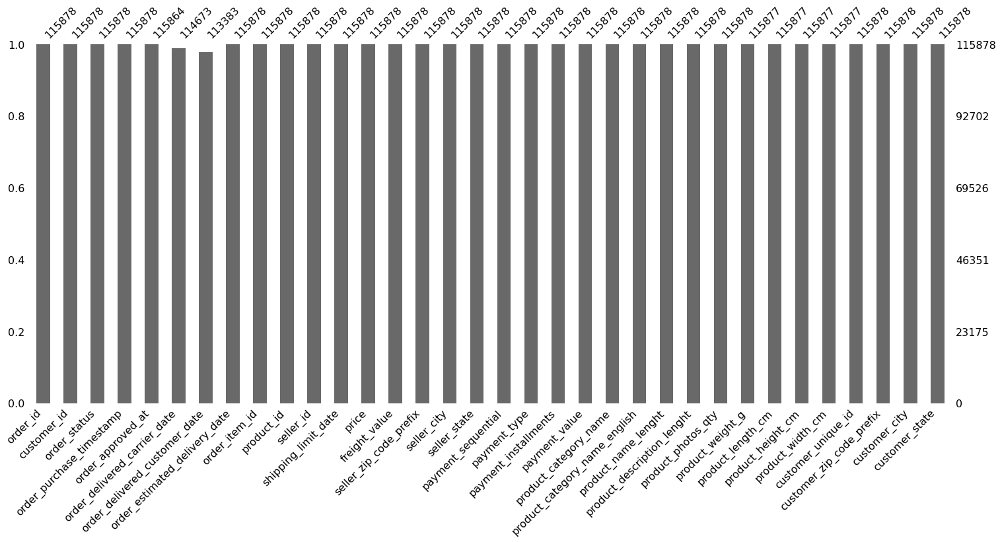

In [ ]:
#plotting data for easier understanding
#missingno is a great library for visualizing missing data.
msno.bar(final_df)

*From the Above, we can't see  much missing values in the required features for our usecase. We are going to extract and filter only the required features and continue further processing*

In [ ]:
# print all the existing status of the orders
final_df['order_status'].unique()

array(['delivered', 'shipped', 'invoiced', 'canceled', 'processing',
       'unavailable', 'approved'], dtype=object)

In [ ]:
#for our analysis we are checking only delivered products
delivered = final_df[final_df['order_status']=='delivered']

**Since our business problem is Customer Segmentation based on RMF analysis, we are going to use only few features for this usecase. Dropping unnecessary features**

In [ ]:
#filtering only necessary features for the problem statement: customer segmentation 
filtered_df = delivered.drop(columns=['order_approved_at', 'order_delivered_carrier_date',
       'order_delivered_customer_date', 'order_estimated_delivery_date','shipping_limit_date',
       'product_name_lenght','seller_zip_code_prefix','seller_city',
       'seller_state','payment_installments','payment_sequential', 'payment_type','payment_value',
       'product_description_lenght', 'product_photos_qty', 'product_weight_g',
       'product_length_cm', 'product_height_cm', 'product_width_cm',
       'customer_unique_id','product_category_name'
       ])

In [ ]:
# final list of columns 
filtered_df.columns

Index(['order_id', 'customer_id', 'order_status', 'order_purchase_timestamp',
       'order_item_id', 'product_id', 'seller_id', 'price', 'freight_value',
       'product_category_name_english', 'customer_zip_code_prefix',
       'customer_city', 'customer_state'],
      dtype='object')

In [ ]:
#removing duplicates since customer made payment in multiple payment sequence for a single order(credit card,voucher,cash,etc..)
customer_filtered = filtered_df.drop_duplicates()

In [ ]:
#finding total value of the order = price + freight_value
customer_filtered.loc[:,'total_order_value']=customer_filtered.loc[:,'price']+customer_filtered.loc[:,'freight_value']

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/pandas/core/indexing.py:376: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/pandas/core/indexing.py:494: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#drop price and freight value post combining them into a new column
customer_filtered.drop(columns=['price','freight_value'],inplace=True)

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/pandas/core/frame.py:4117: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



*To comprehend the customer's behavior RFM metrics are important because frequency and monetary value influence a customer's lifetime value, and recency influences retention, which is a measure of engagement.
Here, the frequency of customers is calculated by counting each customer's order id; the higher the count, the more frequently the customer purchases from the store.*

**FREQUENCY**

In [ ]:
#lets find the frequency of customer orders
Customer_order_frequency = customer_filtered.groupby('customer_id')['order_id'].count().to_frame()
Customer_order_frequency.rename(columns={'order_id':'Frequency'},inplace=True)

In [ ]:
#finding the customer order frequency
Customer_order_frequency.sort_values('Frequency',ascending=False)

,Frequency
customer_id,
fc3d1daec319d62d49bfb5e1f83123e9,21
be1b70680b9f9694d8c70f41fa3dc92b,20
bd5d39761aa56689a265d95d8d32b8be,20
adb32467ecc74b53576d9d13a5a55891,15
10de381f8a8d23fff822753305f71cae,15
...,...
5a158dfc1554dd2b4fe7f3c2581993bd,1
5a1523d32a6d1b323a05895f5164655d,1
5a141d03e70c4c36cfcce2d07cc42f72,1


**RECENCY**

Calculating Recency, here we are calculating recency by subtracting the very recent date with the last transaction date of the customers.

In [ ]:
#sort by order_purchase_timestamp to view the recent purchase made.
customer_filtered.sort_values('order_purchase_timestamp',ascending=False).head()

,order_id,customer_id,order_status,order_purchase_timestamp,order_item_id,product_id,seller_id,product_category_name_english,customer_zip_code_prefix,customer_city,customer_state,total_order_value
31060,35a972d7f8436f405b56e36add1a7140,898b7fee99c4e42170ab69ba59be0a8b,delivered,2018-08-29 15:00:37,1,d04857e7b4b708ee8b8b9921163edba3,9f505651f4a6abe901a56cdc21508025,computers_accessories,13483,limeira,SP,93.75
108061,03ef5dedbe7492bdae72eec50764c43f,496630b6740bcca28fce9ba50d8a26ef,delivered,2018-08-29 14:52:00,1,c7f27c5bef2338541c772b5776403e6a,7d7866a99a8656a42c7ff6352a433410,party_supplies,9541,sao caetano do sul,SP,33.23
47792,168626408cb32af0ffaf76711caae1dc,6e353700bc7bcdf6ebc15d6de16d7002,delivered,2018-08-29 14:18:28,1,bdcf6a834e8faa30dac3886c7a58e92e,2a84855fd20af891be03bc5924d2b453,health_beauty,38600,paracatu,MG,61.29
63527,0b223d92c27432930dfe407c6aea3041,e60df9449653a95af4549bbfcb18a6eb,delivered,2018-08-29 14:18:23,2,2b4472df15512a2825ae86fd9ae79335,67bf6941ba2f1fa1d02c375766bc3e53,kitchen_dining_laundry_garden_furniture,80045,curitiba,PR,255.48
63526,0b223d92c27432930dfe407c6aea3041,e60df9449653a95af4549bbfcb18a6eb,delivered,2018-08-29 14:18:23,1,2b4472df15512a2825ae86fd9ae79335,67bf6941ba2f1fa1d02c375766bc3e53,kitchen_dining_laundry_garden_furniture,80045,curitiba,PR,255.48


*Since, the **last purchase date is '2018-08-29'**, lets consider **current date as the  '2018-08-30'** for the purpose of analysis*

In [ ]:
#convert timestamp to date
customer_filtered['order_purchase_timestamp'] = pd.to_datetime(customer_filtered['order_purchase_timestamp']).dt.date

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#rename column to order_date
customer_filtered.rename(columns={'order_purchase_timestamp':'order_date'},inplace=True)

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/pandas/core/frame.py:4238: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#mention current_Date as recent date+1 ('2018-08-30') for the purpose of analysis
current_date=max(customer_filtered['order_date'])+pd.Timedelta(days=1)

#Recent days calculation from order_date
customer_filtered['Recently']=current_date-customer_filtered['order_date']

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/ipykernel_launcher.py:5: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
#create new df for uderstanding
Recently=customer_filtered

In [ ]:
#group by customers_id nased on the recent order date
Recently=customer_filtered.groupby('customer_id')['Recently'].min().to_frame()
Recently['Recently'] = Recently['Recently'].dt.days.astype('int')

In [ ]:
Recently

,Recently
customer_id,
00012a2ce6f8dcda20d059ce98491703,289
000161a058600d5901f007fab4c27140,410
0001fd6190edaaf884bcaf3d49edf079,548
0002414f95344307404f0ace7a26f1d5,379
000379cdec625522490c315e70c7a9fb,150
...,...
fffcb937e9dd47a13f05ecb8290f4d3e,166
fffecc9f79fd8c764f843e9951b11341,154
fffeda5b6d849fbd39689bb92087f431,100


**MONETARY**

Now, Lets calculate the monetary by summing up all the amounts of the customer.

In [ ]:
#calculate monetary for each customer
Monetary = customer_filtered.groupby('customer_id')['total_order_value'].sum().to_frame()
Monetary.rename(columns={'total_order_value':'MonetaryValue'},inplace=True)

**Now, Lets merge Frequency, Monetary, Recently in a single Dataframe for Customer Segmentation**

In [ ]:
#merging monetary and frequency
Monetary_frequency = pd.merge(Monetary,Customer_order_frequency,how='inner',left_index=True,right_index=True)

In [ ]:
Monetary_frequency

,MonetaryValue,Frequency
customer_id,,
00012a2ce6f8dcda20d059ce98491703,114.74,1
000161a058600d5901f007fab4c27140,67.41,1
0001fd6190edaaf884bcaf3d49edf079,195.42,1
0002414f95344307404f0ace7a26f1d5,179.35,1
000379cdec625522490c315e70c7a9fb,107.01,1
...,...,...
fffcb937e9dd47a13f05ecb8290f4d3e,91.91,1
fffecc9f79fd8c764f843e9951b11341,81.36,1
fffeda5b6d849fbd39689bb92087f431,63.13,1


In [ ]:
#finally merge Monetary_frequency with Recently to get RMF for each customer
Customer_RMF= pd.merge(Monetary_frequency,Recently,how='inner',left_index=True,right_index=True)

In [ ]:
Customer_RMF

,MonetaryValue,Frequency,Recently
customer_id,,,
00012a2ce6f8dcda20d059ce98491703,114.74,1,289
000161a058600d5901f007fab4c27140,67.41,1,410
0001fd6190edaaf884bcaf3d49edf079,195.42,1,548
0002414f95344307404f0ace7a26f1d5,179.35,1,379
000379cdec625522490c315e70c7a9fb,107.01,1,150
...,...,...,...
fffcb937e9dd47a13f05ecb8290f4d3e,91.91,1,166
fffecc9f79fd8c764f843e9951b11341,81.36,1,154
fffeda5b6d849fbd39689bb92087f431,63.13,1,100


In [ ]:
#describe the df columns
Customer_RMF.describe()

,MonetaryValue,Frequency,Recently
count,95126.000000,95126.000000,95126.000000
mean,159.959175,1.142012,239.945294
std,218.700486,0.538617,152.824978
min,9.590000,1.000000,1.000000
25%,61.980000,1.000000,116.000000
50%,105.160000,1.000000,221.000000
75%,176.810000,1.000000,350.000000
max,13664.080000,21.000000,696.000000


/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2103: FutureWarning:

The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2103: FutureWarning:

The `axis` varia

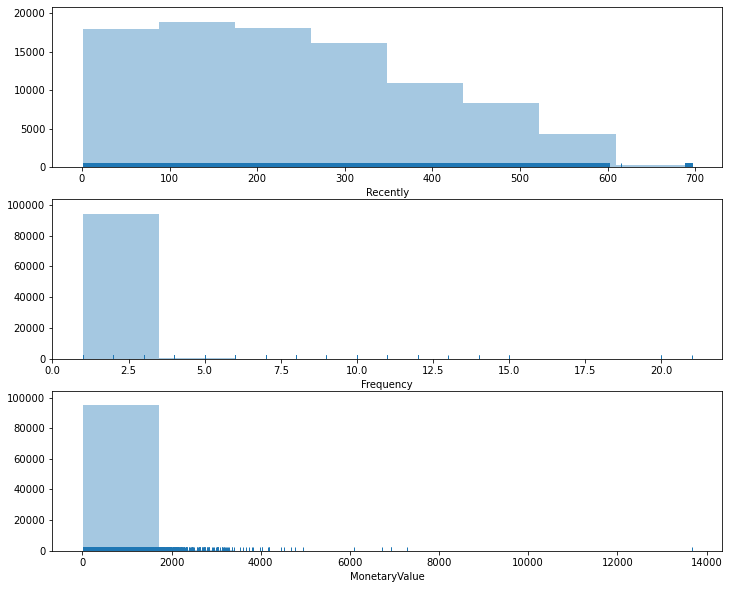

In [ ]:
# Plot RFM distributions
plt.figure(figsize=(12,10))
# Plot distribution of R
plt.subplot(3, 1, 1); sns.distplot(Customer_RMF['Recently'],bins=8,kde=False,rug=True)
# Plot distribution of F
plt.subplot(3, 1, 2); sns.distplot(Customer_RMF['Frequency'],bins=8,kde=False,rug=True)
# Plot distribution of M
plt.subplot(3, 1, 3); sns.distplot(Customer_RMF['MonetaryValue'],bins=8,kde=False,rug=True)
# Show the plot
plt.show()

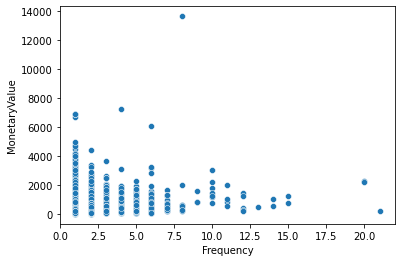

In [ ]:
#lets plot Frequency vs MonetaryValue to understanding the behavior of the customer
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RMF)

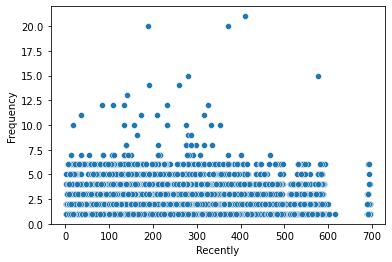

In [ ]:
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RMF)

**NORMALIZING VALUE PRIOR CLUSTERING**

In [ ]:
#Now lets standadize the scale
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
normalized= scaler.fit_transform(Customer_RMF)

In [ ]:
#creating normalized dataframe
Customer_RFM_normalized=pd.DataFrame(normalized)

In [ ]:
#rename columns for understanding
Customer_RFM_normalized.rename(columns={0:'MonetaryValue',1:'Frequency',2:'Recently'},inplace=True)

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2103: FutureWarning:

The `axis` variable is no longer used and will be removed. Instead, assign variables directly to `x` or `y`.

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2619: FutureWarning:

`distplot` is a deprecated function and will be removed in a future version. Please adapt your code to use either `displot` (a figure-level function with similar flexibility) or `histplot` (an axes-level function for histograms).

/anaconda/envs/azureml_py36/lib/python3.6/site-packages/seaborn/distributions.py:2103: FutureWarning:

The `axis` varia

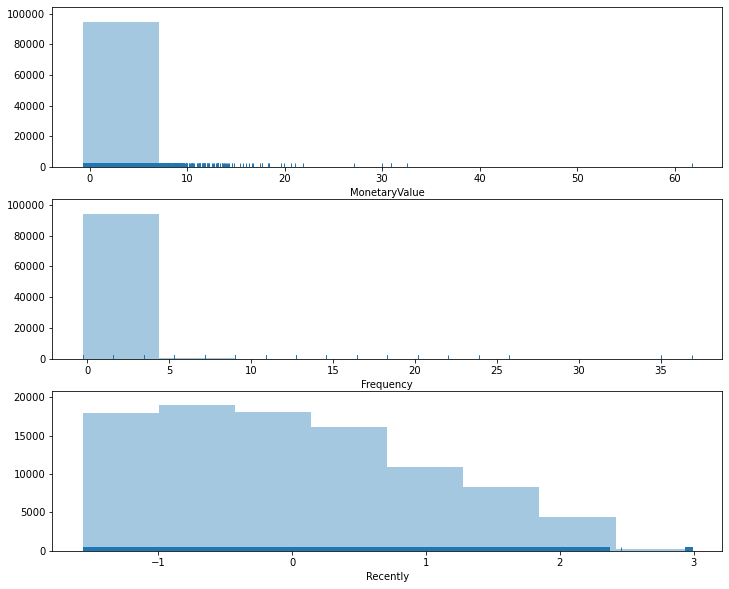

In [ ]:
# Plot RFM distributions post normalization
plt.figure(figsize=(12,10))
# Plot distribution of M
plt.subplot(3, 1, 1); sns.distplot(Customer_RFM_normalized['MonetaryValue'],bins=8,kde=False,rug=True)
# Plot distribution of F
plt.subplot(3, 1, 2); sns.distplot(Customer_RFM_normalized['Frequency'],bins=8,kde=False,rug=True)
# Plot distribution of R
plt.subplot(3, 1, 3); sns.distplot(Customer_RFM_normalized['Recently'],bins=8,kde=False,rug=True)
# Show the plot
plt.show()

*From the Above , we can say most of the customers are in the frequency range of 1-5 trasactions in our Store.*

#### **CLUSTERING ON RMF values of Customer to understand Customer Buying Behavior**

**Gaussian Mixture Clustering**

In [ ]:
from sklearn.mixture import GaussianMixture

# Fit models with 1-10 components
k_arr = np.arange(10) + 1
models = [
 GaussianMixture(n_components=k).fit(tmp)
 for k in k_arr
]

In [ ]:
# Plot function
def plot_mixture(gmm, X, show_legend=True, ax=None):
 if ax is None:
    ax = plt.gca()

 # Compute PDF of whole mixture
 x = np.linspace(-6, 6, 1000)
 logprob = gmm.score_samples(x.reshape(-1, 1))
 pdf = np.exp(logprob)

 # Compute PDF for each component
 responsibilities = gmm.predict_proba(x.reshape(-1, 1))
 pdf_individual = responsibilities * pdf[:, np.newaxis]
 # Plot data histogram
 ax.hist(X, 30, density=True, histtype='stepfilled', alpha=0.4, label
='Data')

 # Plot PDF of whole model
 ax.plot(x, pdf, '-k', label='Mixture PDF')

 # Plot PDF of each component
 ax.plot(x, pdf_individual, '--', label='Component PDF')
 ax.set_xlabel('$x$')
 ax.set_ylabel('$p(x)$')
 if show_legend:
    ax.legend()

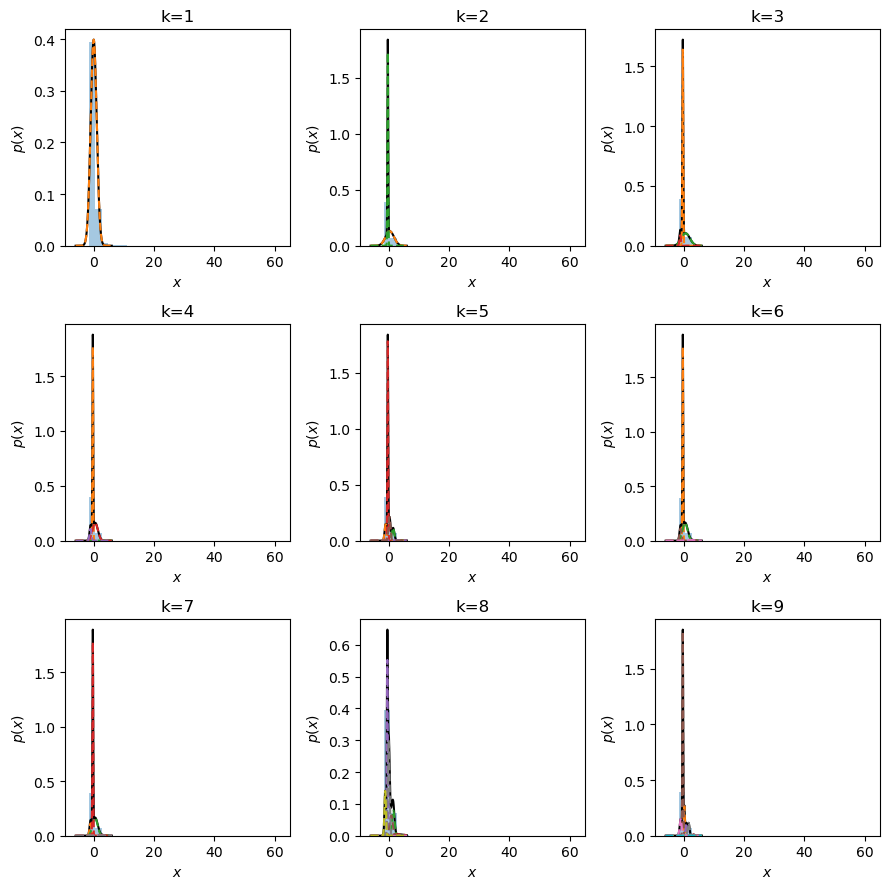

In [ ]:
 # Show all models for n_components 1 to 9
_, axes = plt.subplots(3, 3, figsize=np.array([3,3])*3, dpi=100)
for gmm, ax in zip(models, axes.ravel()):
    plot_mixture(gmm, tmp, show_legend=False, ax=ax)
    ax.set_title(f'k={gmm.n_components}')
    plt.tight_layout()

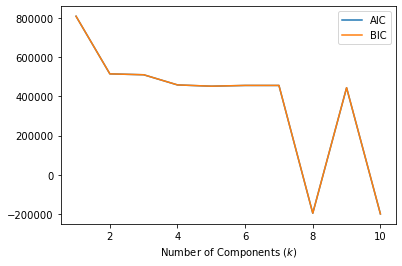

In [ ]:
# Compute metrics to determine best hyperparameter
AIC = [m.aic(tmp) for m in models]
BIC = [m.bic(tmp) for m in models]
# Plot these metrics
plt.plot(k_arr, AIC, label='AIC')
plt.plot(k_arr, BIC, label='BIC')
plt.xlabel('Number of Components ($k$)')
plt.legend()

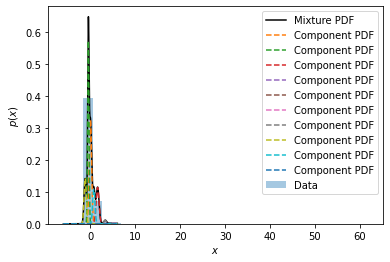

In [ ]:
gmm_best = models[np.argmin(AIC)]
plot_mixture(gmm_best, tmp)

**Peroform Gaussina Mixture on the Actual Data**

In [ ]:
gmm = GaussianMixture(n_components=4, random_state=0).fit(Customer_RFM_normalized)
gmm_labels = gmm.predict(Customer_RFM_normalized)

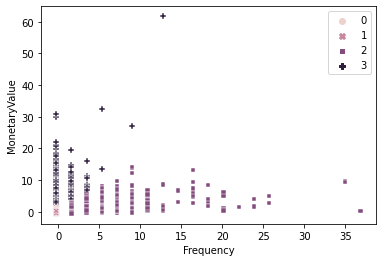

In [ ]:
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized,hue=gmm_labels,style=gmm_labels)

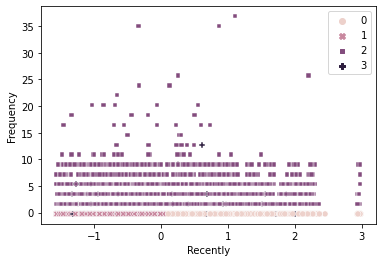

In [ ]:
#lets plot recently vs frequency to understanding the behavior of the customer
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized,hue=gmm_labels,style=gmm_labels)

In [ ]:
Customer_RFM_normalized_gmm=Customer_RFM_normalized.copy()
Customer_RFM_normalized_gmm['Cluster_Category'] = gmm_labels
Customer_RFM_normalized_gmm.loc[:,'customer_id'] = Customer_RMF.index

In [ ]:
Customer_RFM_normalized_gmm.groupby('Cluster_Category')['customer_id'].count()

Cluster_Category
0    35996
1    47028
2     9369
3     2733
Name: customer_id, dtype: int64

In [ ]:
#3d plot post gmm
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=gmm_labels)
fig.show()

**BIRCH CLUSTERING**

In [ ]:
from sklearn.cluster import Birch
clustering = Birch(n_clusters=4).fit_predict(Customer_RFM_normalized)

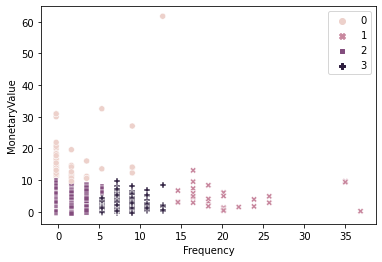

In [ ]:
sns.scatterplot(x='Frequency',y='MonetaryValue',data=Customer_RFM_normalized,hue=clustering,style=clustering)

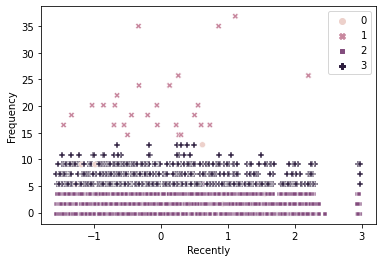

In [ ]:
sns.scatterplot(x='Recently',y='Frequency',data=Customer_RFM_normalized,hue=clustering,style=clustering)

In [ ]:
Customer_RFM_normalized_birch=Customer_RFM_normalized.copy()
Customer_RFM_normalized_birch['Cluster_Category'] = clustering
Customer_RFM_normalized_birch.loc[:,'customer_id'] = Customer_RMF.index

In [ ]:
Customer_RFM_normalized_birch.groupby('Cluster_Category')['customer_id'].count()

Cluster_Category
0       88
1       27
2    94130
3      881
Name: customer_id, dtype: int64

In [ ]:
#3d plot post birch
fig = px.scatter_3d(Customer_RFM_normalized, x='MonetaryValue', y='Frequency', z='Recently',
              color=clustering)
fig.show()